In [1]:
import os

import cv2
import numpy as np
from scipy import signal

from utils.OpticalFlowUtils import FlowReader
from utils.OpticalFlowUtils import FlowVisualiser

from assets.ml.src.POIFE_model import POIFE_TrunkNET
from assets.ml.src.POIFE_model import POIFE_BranchNET
from assets.ml.src.POIFE_model import OpticalFlowOperatorNetwork

2024-02-19 13:02:43.487314: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
reader = FlowReader()
visualiser = FlowVisualiser()

In [3]:
SINTEL_PATH = os.path.join("..", "Data", "MPI-Sintel")
SINTEL_TRAINING_PATH = os.path.join(SINTEL_PATH, "training")
SINTEL_TRAINING_FLOW_PATH = os.path.join(SINTEL_TRAINING_PATH, "flow")
SINTEL_TRAINING_IMG_PATH = os.path.join(SINTEL_TRAINING_PATH, "clean")

In [4]:
print(f"SINTEL PATH: {SINTEL_PATH}")
print(f"SINTEL TRAINING PATH: {SINTEL_TRAINING_PATH}")
print(f"SINTEL TRAINING FLOW PATH: {SINTEL_TRAINING_FLOW_PATH}")
print(f"SINTEL TRAINING IMG PATH: {SINTEL_TRAINING_IMG_PATH}")

SINTEL PATH: ../Data/MPI-Sintel
SINTEL TRAINING PATH: ../Data/MPI-Sintel/training
SINTEL TRAINING FLOW PATH: ../Data/MPI-Sintel/training/flow
SINTEL TRAINING IMG PATH: ../Data/MPI-Sintel/training/clean


In [32]:
# Test Farneback Optical Flow and use that as one of the baselines to beat.
prev = cv2.imread(os.path.join(SINTEL_TRAINING_IMG_PATH, 'alley_1', 'frame_0001.png'))
next = cv2.imread(os.path.join(SINTEL_TRAINING_IMG_PATH, 'alley_1', 'frame_0009.png'))

In [33]:
print(f"Previous Frame shape: {prev.shape}")
print(f"Next frame shape: {next.shape}")

prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
next = cv2.cvtColor(next, cv2.COLOR_BGR2GRAY)

print(f"Previous Frame shape: {prev.shape}")
print(f"Next frame shape: {next.shape}")

Previous Frame shape: (436, 1024, 3)
Next frame shape: (436, 1024, 3)
Previous Frame shape: (436, 1024)
Next frame shape: (436, 1024)


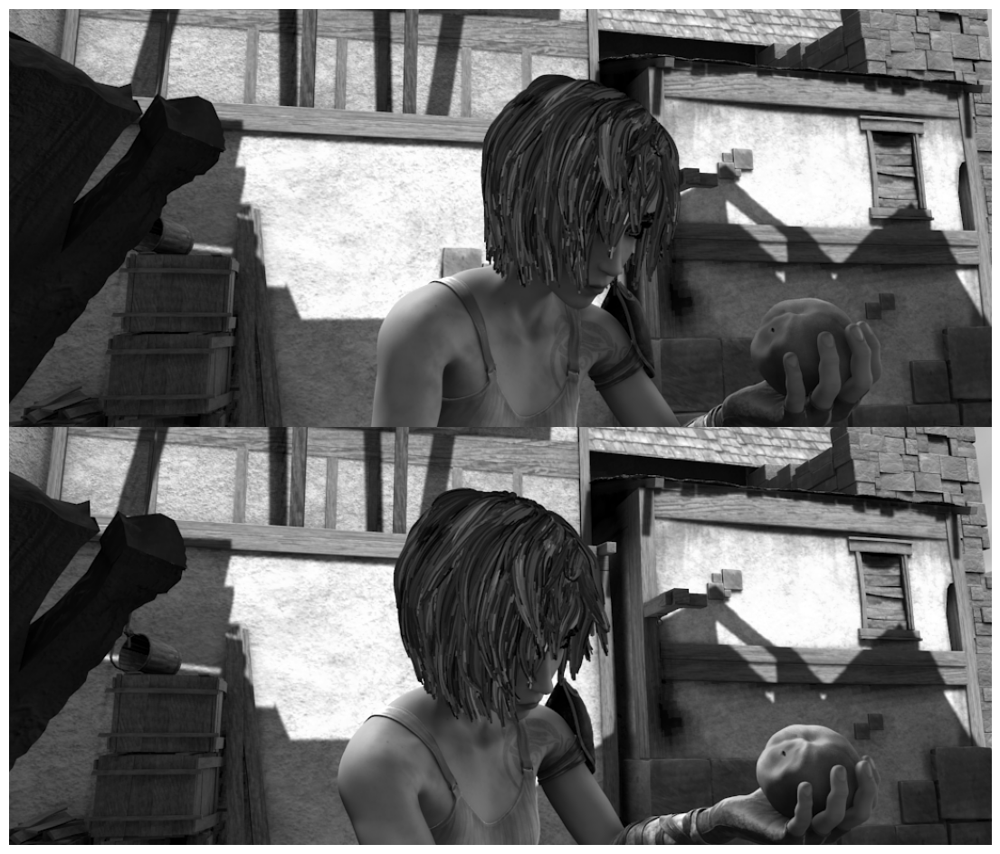

In [37]:
visualiser.imshow(cv2.vconcat([prev, next]))

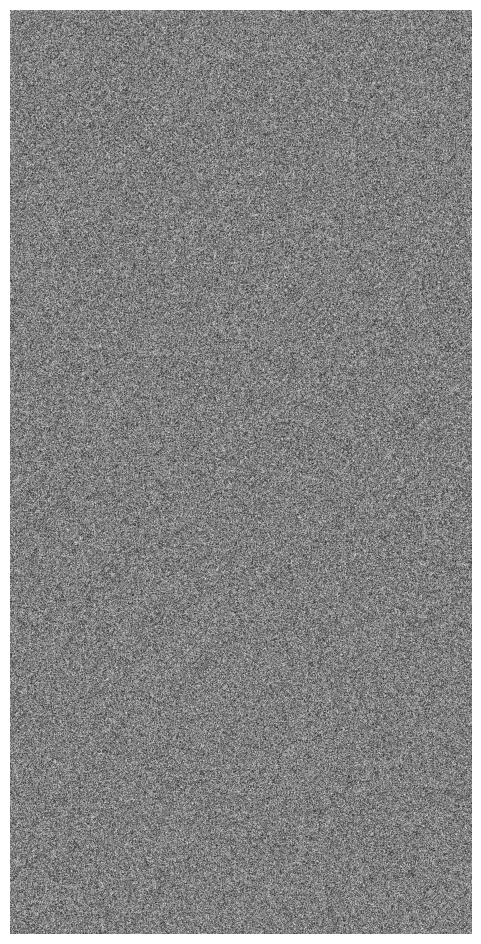

In [38]:
prev_T = prev.T
prev_prev_T = np.dot(prev_T, prev)

next_T = next.T
next_next_T = np.dot(next_T, next)

visualiser.imshow(cv2.vconcat([prev_prev_T, next_next_T]))

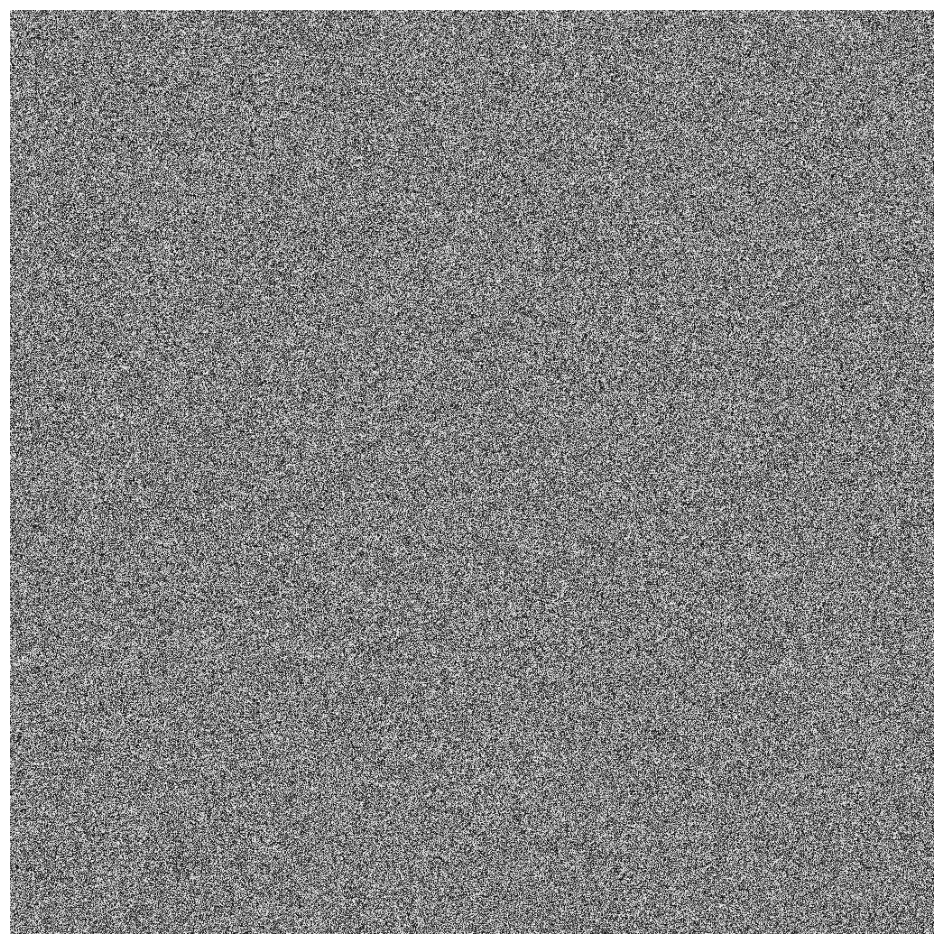

In [39]:
M = np.dot(prev_prev_T, next_next_T)
visualiser.imshow(M)

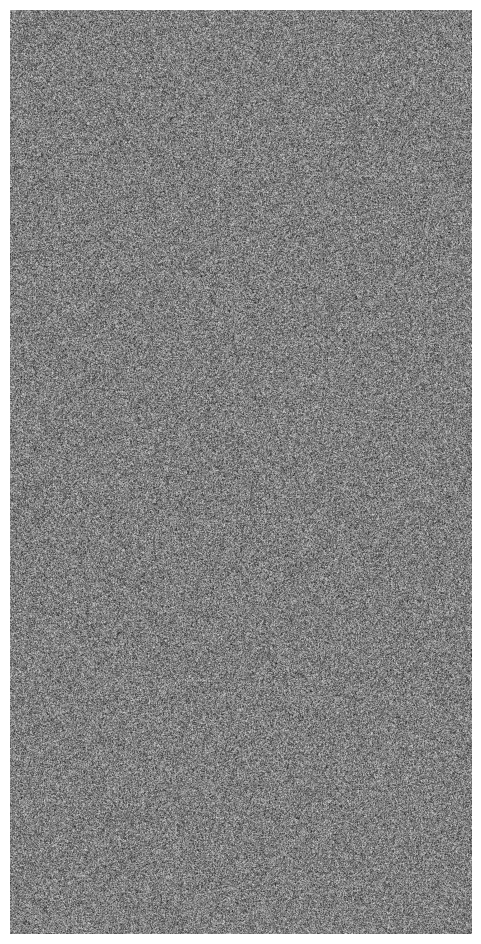

In [40]:
prev_T = prev.T
prev_prev_T = np.dot(next_T, prev)

next_T = next.T
next_next_T = np.dot(prev_T, next)

visualiser.imshow(cv2.vconcat([prev_prev_T, next_next_T]))

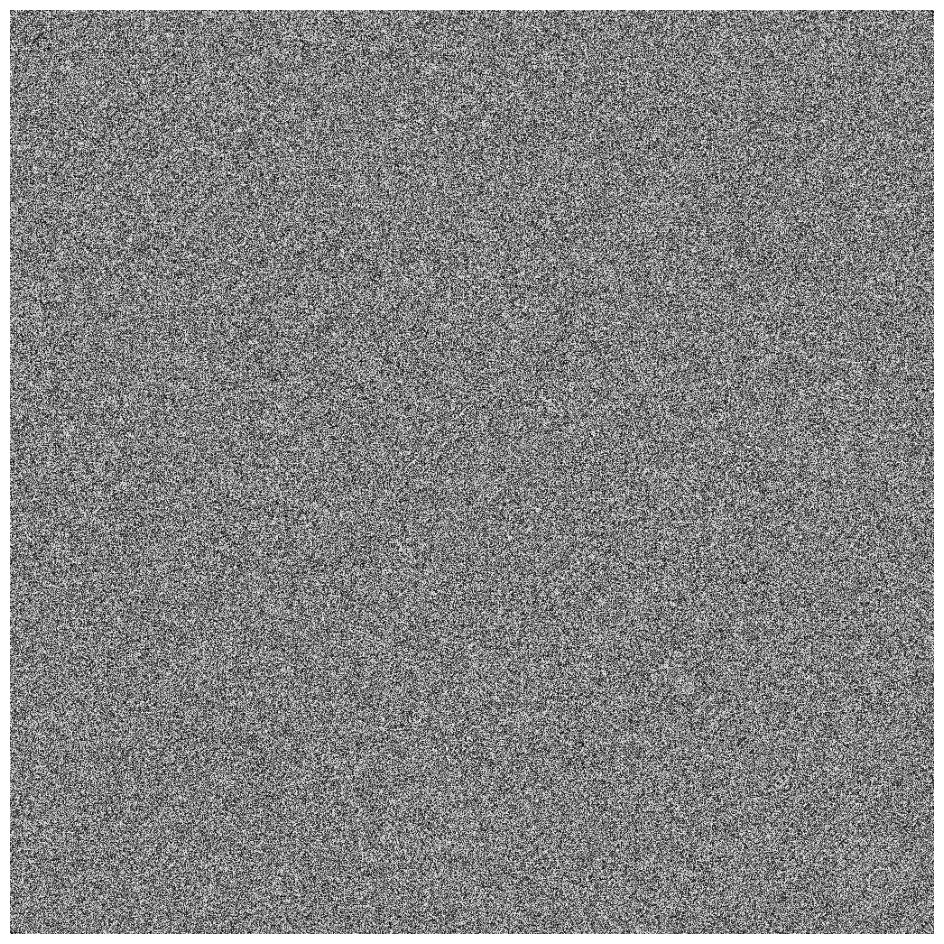

In [41]:
M = np.dot(prev_prev_T, next_next_T)
visualiser.imshow(M)

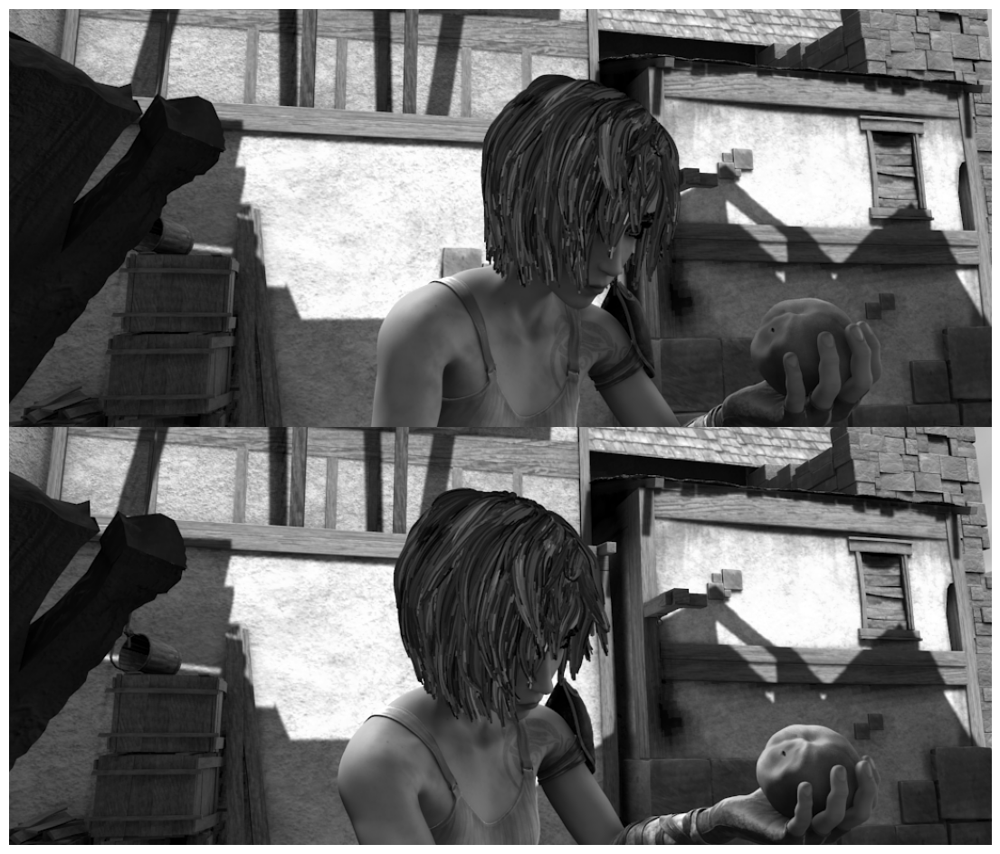

In [42]:
visualiser.imshow(cv2.vconcat([prev, next]))

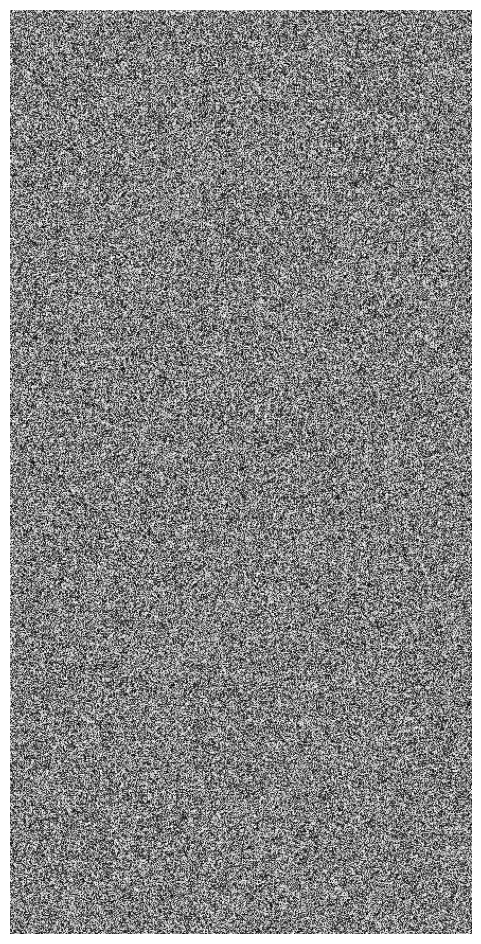

In [43]:
prev_T = prev.T
prev_prev_T = np.dot(prev, next_T)

next_T = next.T
next_next_T = np.dot(next, prev_T)

visualiser.imshow(cv2.vconcat([prev_prev_T, next_next_T]))

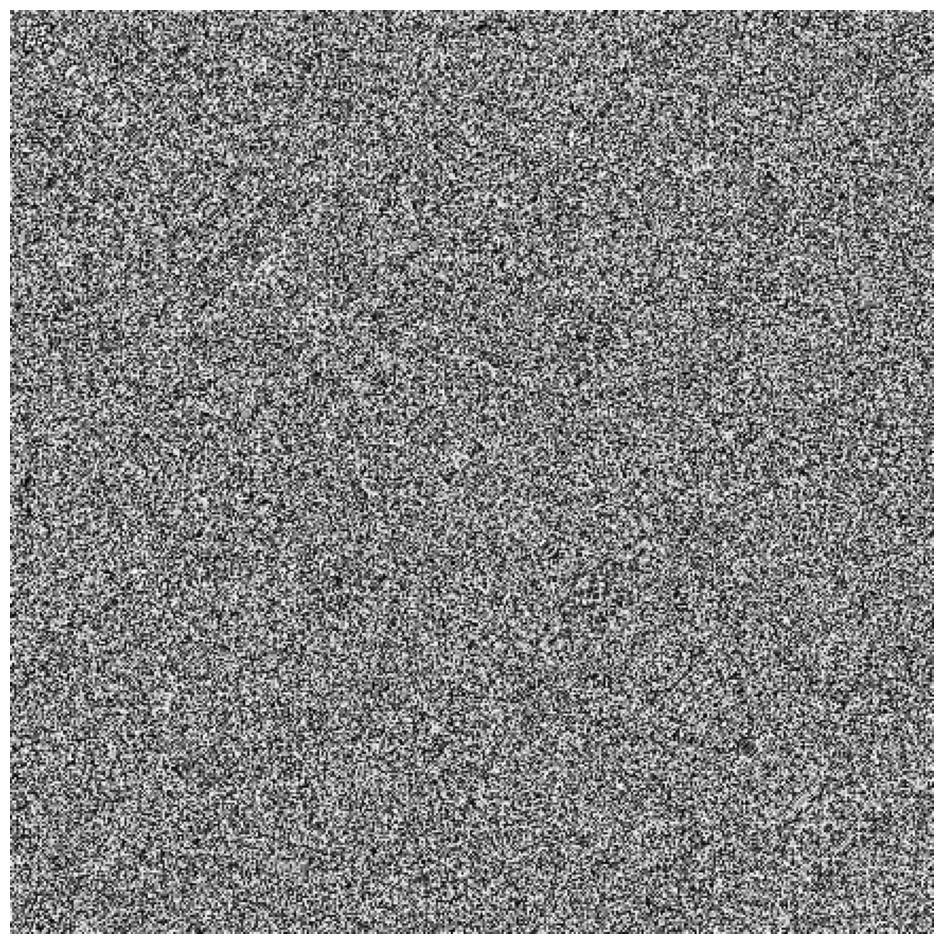

In [44]:
M = np.dot(prev_prev_T, next_next_T)
visualiser.imshow(M)

In [45]:
corr = signal.correlate2d(next[220:280, 560:640], prev)

(495, 1103)


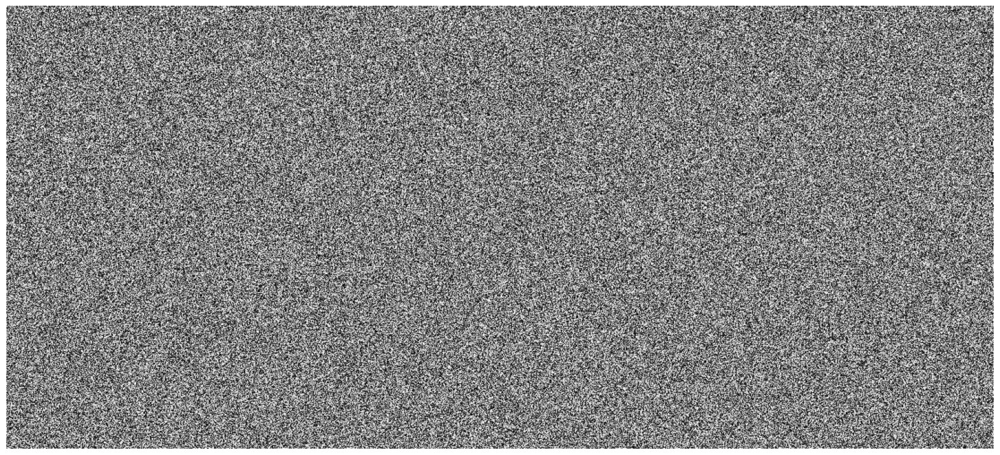

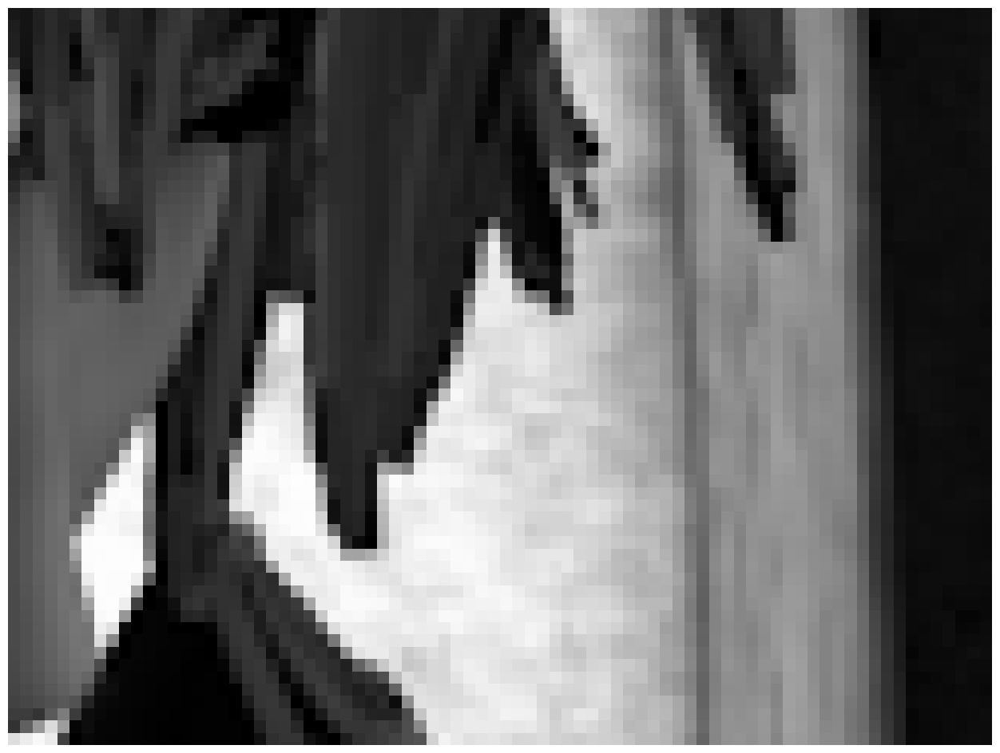

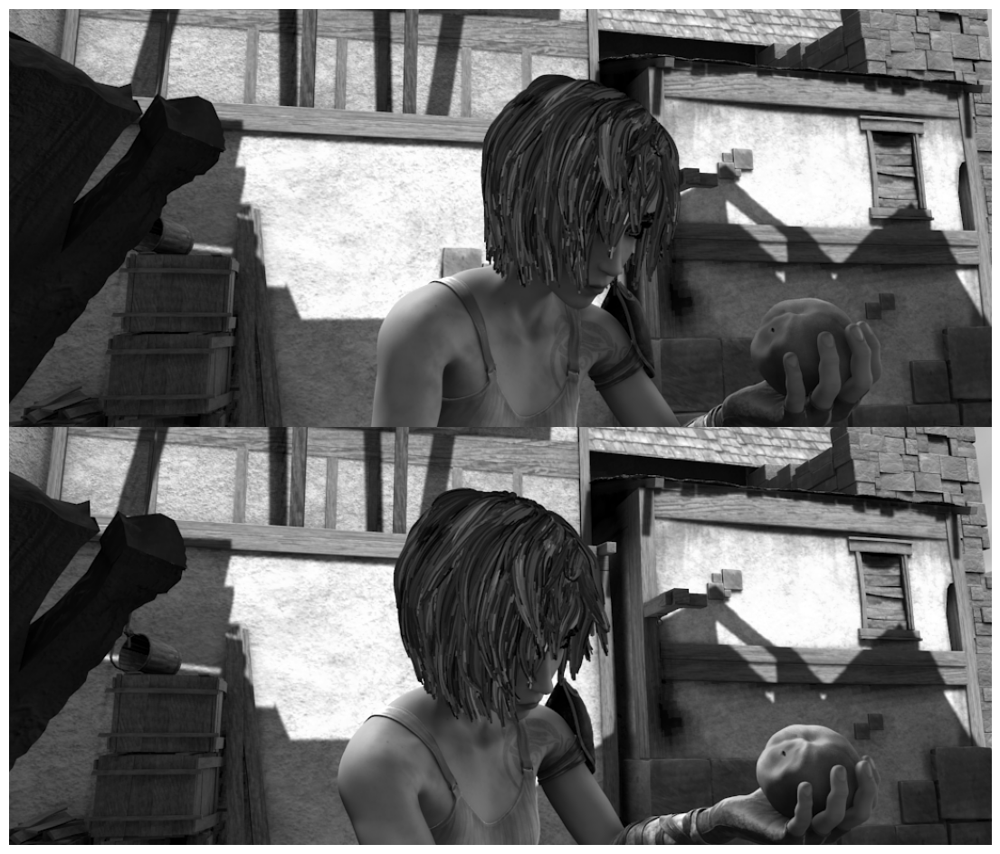

In [46]:
print(corr.shape)
visualiser.imshow(corr)
visualiser.imshow(next[220:280, 560:640])
visualiser.imshow(cv2.vconcat([prev, next]))

In [47]:
np.argmax(corr)

182

In [48]:
np.argmin(corr)  

85

In [49]:
print(np.min(corr)) 

0


In [50]:
print(np.max(corr))

255


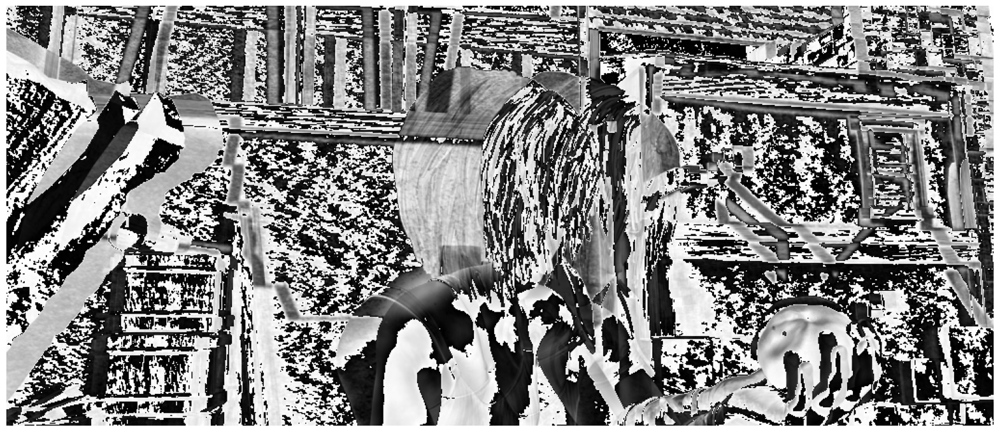

In [51]:
diff = np.subtract(prev, next)
visualiser.imshow(diff)

In [60]:
concat = np.concatenate([prev.reshape(prev.shape[0], prev.shape[1], 1), next.reshape(next.shape[0], next.shape[1], 1), np.zeros_like(next.reshape(next.shape[0], next.shape[1], 1))], axis=-1)
concat.shape

(436, 1024, 3)

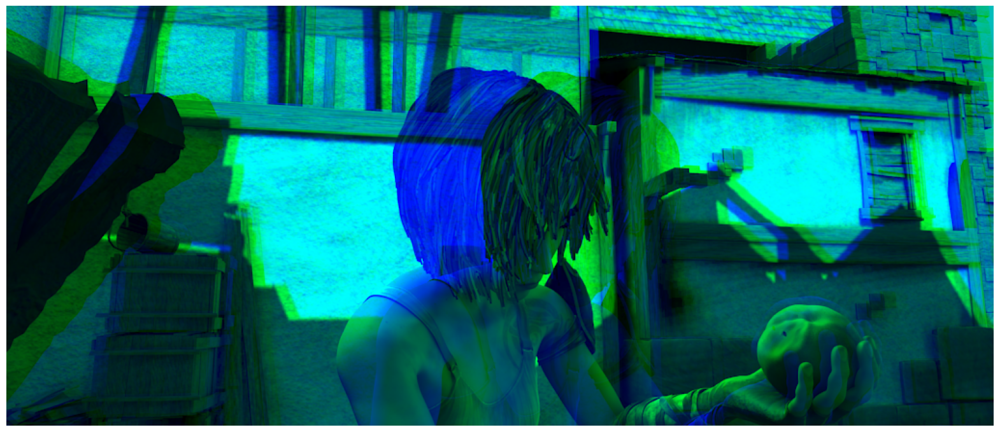

In [61]:
visualiser.imshow(concat)

In [2]:
trunkNET = POIFE_TrunkNET()

trunkNET.build(input_shape=(None, 2))
trunkNET.summary()

Model: "poife__trunk_net"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 2)]               0         
                                                                 
 POIFE_TrunkLayer_0 (Dense)  multiple                  1200      
                                                                 
 POIFE_TrunkLayer_1 (Dense)  multiple                  160400    
                                                                 
 POIFE_TrunkLayer_2 (Dense)  multiple                  160400    
                                                                 
 POIFE_TrunkLayer_3 (Dense)  multiple                  160400    
                                                                 
 POIFE_TrunkLayer_4 (Dense)  multiple                  160400    
                                                                 
 POIFE_TrunkLayer_5 (Dense)  multiple             

In [3]:
testX = np.array([0, 0])
out = trunkNET(testX.reshape(-1, testX.shape[0]))

print(out)
print(out.shape)

tf.Tensor(
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]], shape=(1, 250), dtype=float32)
(1, 250)


In [4]:
testX = np.array([436, 1024])
out = trunkNET(testX.reshape(-1, testX.shape[0]))

print(out)
print(out.shape)

tf.Tensor(
[[-0.02475974  0.060428   -0.1952086   0.02868947 -0.37808827  0.19351423
  -0.03032831 -0.11443929 -0.412017    0.52002984  0.16230392 -0.05769245
   0.01500917  0.22272444 -0.03637888 -0.06716555 -0.18906254  0.01468064
  -0.26434267 -0.35242948  0.2018075  -0.24559218  0.11613774 -0.469324
  -0.09619449  0.02331138  0.20020181  0.12320428 -0.04869053 -0.27799493
   0.19340332  0.11679367  0.24268314  0.19101912 -0.12984192 -0.05677134
   0.06706664  0.03526986  0.07597485 -0.22395769 -0.00668342  0.44436887
  -0.21994212  0.24422708 -0.021144   -0.3242272   0.3129648   0.10696942
  -0.25052118  0.12898551  0.43067372 -0.42757672 -0.00782049 -0.01518727
  -0.03511447 -0.12494469 -0.48120087  0.05008663  0.05439363  0.15835282
   0.08875521 -0.16407925  0.42046246  0.5888397  -0.04596133 -0.21405701
  -0.10749477  0.23385872 -0.14704646  0.07628709  0.39968413  0.26455665
  -0.14007854  0.21234405 -0.14693017  0.09328011 -0.38366652 -0.48294204
   0.06848527  0.2552052  -0.

In [5]:
branchNET = POIFE_BranchNET()

branchNET.build(input_shape=(None, 2, 436, 1024, 1))
branchNET.summary()

Model: "poife__branch_net"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             multiple                  304       
                                                                 
 max_pooling2d (MaxPooling2  multiple                  0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           multiple                  4640      
                                                                 
 batch_normalization (Batch  multiple                  128       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     multiple                  0         
                                                                 
 conv2d_2 (Conv2D)           multiple            

In [6]:
testX = np.zeros(shape=(1, 2, 436, 1024, 1))
print(testX.shape)

(1, 2, 436, 1024, 1)


In [7]:
out = branchNET(testX)
print(out)
print(out.shape)

tf.Tensor(
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]], shape=(1, 250), dtype=float32)
(1, 250)


In [8]:
testX = 0.5*np.ones(shape=(1, 2, 436, 1024, 1))
print(testX.shape)

(1, 2, 436, 1024, 1)


In [9]:
out = branchNET(testX)
print(out)
print(out.shape)

tf.Tensor(
[[-5.20427828e-04  1.53587796e-04 -2.17162829e-04 -2.24204647e-04
  -7.47458544e-04 -9.52154980e-04  4.44800360e-04 -2.21679948e-04
  -5.81354136e-04 -8.26063158e-04  2.41680726e-04 -1.18092215e-03
   3.66942055e-04 -1.38280753e-04  5.15919346e-05 -1.04172941e-05
   1.48900272e-03  9.30337483e-05 -7.11898261e-04  5.82148554e-04
  -3.73616058e-04  5.62640664e-04 -1.18047778e-04 -6.69227098e-04
  -4.08593682e-04 -4.96941386e-04 -2.74154765e-04 -8.56441475e-05
   8.87749775e-04 -1.60502299e-04 -1.80352625e-04  5.53204794e-04
   7.07683270e-04 -2.52264901e-04  1.75975001e-04  4.71977022e-04
  -4.94156382e-04  8.15307139e-05  4.05473344e-04 -1.16435392e-03
   7.35265436e-04  2.85910646e-05 -2.30576552e-04  5.45759103e-04
  -6.21153333e-04  6.80988596e-04 -1.03866740e-03 -7.73644861e-05
  -3.06129397e-04  4.32284753e-04 -3.08101444e-04 -4.89456230e-04
   7.05853512e-04 -5.81392145e-04 -1.38875446e-03 -2.96754559e-04
  -3.85085790e-04  4.08892520e-04 -3.09815368e-04 -3.77857621e-04

In [10]:
deepONET = OpticalFlowOperatorNetwork()

deepONET.build(input_shape=[(None, 2, 436, 1024, 1), (None, 2)])
deepONET.summary()

Model: "optical_flow_operator_network"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 poife__branch_net_1 (POIFE  multiple                  12585418  
 _BranchNET)                                                     
                                                                 
 poife__trunk_net_1 (POIFE_  multiple                  1545050   
 TrunkNET)                                                       
                                                                 
 bias_layer (BiasLayer)      multiple                  1         
                                                                 
 bias_layer_1 (BiasLayer)    multiple                  1         
                                                                 
Total params: 14130470 (53.90 MB)
Trainable params: 14125542 (53.88 MB)
Non-trainable params: 4928 (19.25 KB)
___________________________________________________________

In [11]:
testBranch = 0.5*np.ones(shape=(1, 2, 436, 1024, 1))
testTrunk = np.array([236, 1024])
testTrunk = testTrunk.reshape(-1, testTrunk.shape[0])

out = deepONET([testBranch, testTrunk])
print(out)

tf.Tensor([[0.00204586 0.00424429]], shape=(1, 2), dtype=float32)


In [12]:
testBranch = 0.5*np.ones(shape=(1, 2, 436, 1024, 1))
testTrunk = np.array([0, 0])
testTrunk = testTrunk.reshape(-1, testTrunk.shape[0])

out = deepONET([testBranch, testTrunk])
print(out)

tf.Tensor([[0. 0.]], shape=(1, 2), dtype=float32)
